# Práctica 1 | Tecnologías de la Imagen y Vídeo
## Estadística de imágenes y operadores puntuales

In [155]:
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from skimage import data, util, exposure, color

### Imagen 1: Mamografía

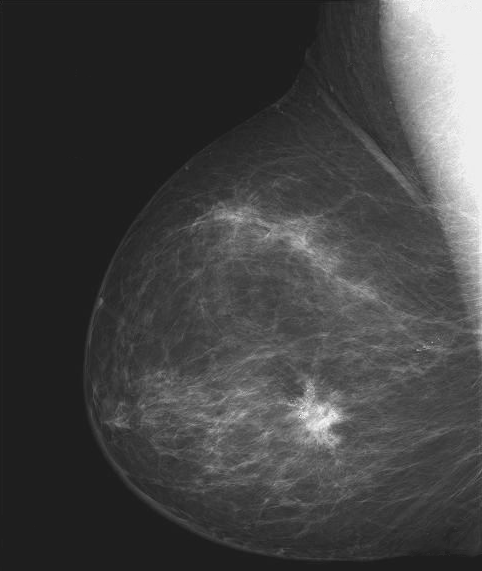

In [156]:
#Apartado 1)
file_mamografia = 'images/breastXray.tif'
img_mamografia  = Image.open(file_mamografia)
display(img_mamografia)

In [157]:
#Apartado 2)a.
img_mamografia_float = np.asarray(img_mamografia, dtype = 'float')

# Principales estadísticos
print('Valor mínimo de imagen Mamografía:', img_mamografia_float.min())
print('Valor máximo de imagen Mamografía:', img_mamografia_float.max())
print('Rango de Mamografía:', img_mamografia_float.max() - img_mamografia_float.min())
print('Media de Mamografía:', img_mamografia_float.mean())
print('Desviación típica de Mamografía:', img_mamografia_float.std())
print('Varianza de Mamografía:', img_mamografia_float.var())
print('Coeficiente de variación de Mamografía:', img_mamografia_float.std() / img_mamografia_float.mean())
img_mamografia_q = np.quantile(img_mamografia, (0.25, 0.5, 0.75))
print('1er cuantil de Mamografía (Q1): ', img_mamografia_q[0], '\nMediana de Mamografía (Q2): ', img_mamografia_q[1], '\n3er cuantil de Mamografía (Q3): ', img_mamografia_q[2],
     '\nRango intercuantil de Mamografía (IQR): ', img_mamografia_q[2]-img_mamografia_q[0], '\nRango medio intercuantil de Mamografía: ', (img_mamografia_q[0]+img_mamografia_q[2])/2)


Valor mínimo de imagen Mamografía: 21.0
Valor máximo de imagen Mamografía: 255.0
Rango de Mamografía: 234.0
Media de Mamografía: 66.7182565347247
Desviación típica de Mamografía: 46.500046005779
Varianza de Mamografía: 2162.254278539563
Coeficiente de variación de Mamografía: 0.6969613479269684
1er cuantil de Mamografía (Q1):  30.0 
Mediana de Mamografía (Q2):  57.0 
3er cuantil de Mamografía (Q3):  82.0 
Rango intercuantil de Mamografía (IQR):  52.0 
Rango medio intercuantil de Mamografía:  56.0


A priori, destaca el valor mínimo, que no llega a cero, lo que sugiere que la imagen no está aprovechando al completo todo el rango de valores de blanco a negro. Esto es algo a tener en cuenta de cara al apartado 3.

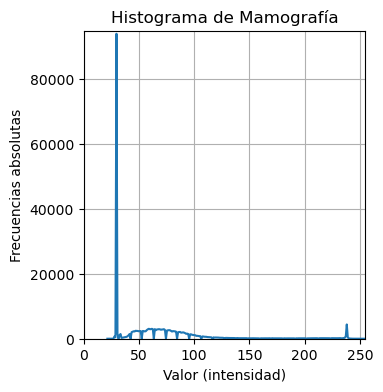

In [158]:
#Apartado 2)b.
# Histograma
plt.figure(figsize=(8, 4))

img_mamografia_hist, bins_mamografia = exposure.histogram(img_mamografia_float, normalize=False)
plt.subplot(121)
plt.plot(bins_mamografia, img_mamografia_hist)
plt.axis([0,255, 0, 1.01*img_mamografia_hist.max()])
plt.title('Histograma de Mamografía')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencias absolutas')
plt.grid()

Sorprende el pico de valores que se encuentran sobre 30. Esto puede corresponderse con el fondo de la imagen.

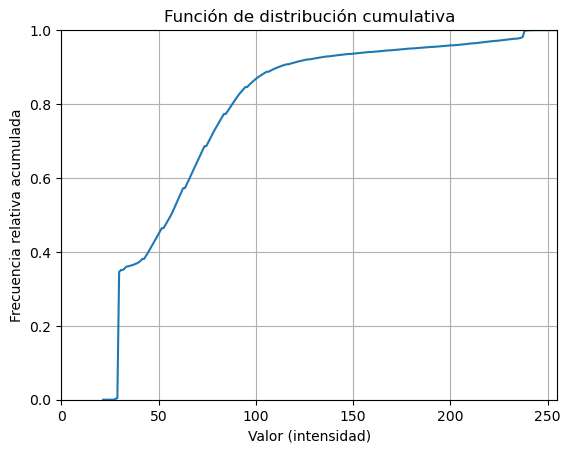

In [159]:
#Apartado 2)b.
# Función de distribución cumulativa
img_mamografia_cdf, bins_mamografia_cdf = exposure.cumulative_distribution(img_mamografia_float)

plt.plot(bins_mamografia_cdf, img_mamografia_cdf)
plt.axis([0,255, 0, 1])
plt.title('Función de distribución cumulativa')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencia relativa acumulada')
plt.grid()

Aquí también se aprecia considerablemente el efecto de que el valor mínimo esté en 21 (no hay ningún valor por debajo) y el gran pico de valores en el entorno del 30, lo que hace que la función de distribución cumulativa dé un gran salto a partir de ese número.

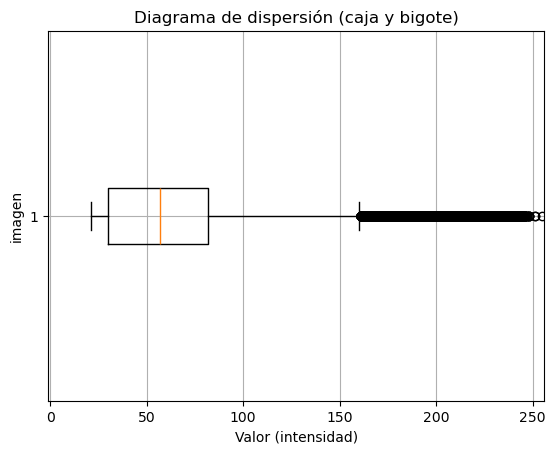

In [160]:
#Apartado 2)c.
# Diagrama de dispersión (caja bigote)
plt.boxplot(img_mamografia_float.flatten(), vert=False)
plt.xlim([-1, 256])
plt.title('Diagrama de dispersión (caja y bigote)')
plt.xlabel('Valor (intensidad)')
plt.ylabel('imagen')
plt.grid()

Es normal que aparezcan valores atípicos en los números más altos, pues la gran cantidad de fondo oscuro que hay en la imagen hace que la distribución se aleje de los valores más cercanos a 255.

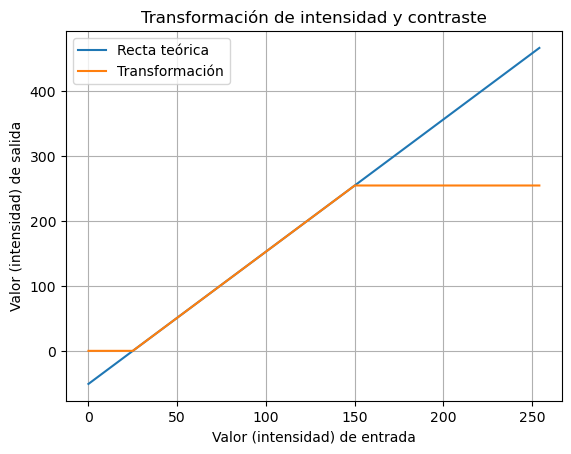

In [161]:
#Apartado 3)

#Definición de la transformación
Mi = 255

Bl = 25
Wl = 150

L = (Bl + Wl)/2
W = Wl - Bl

m = Mi/W
b = -Mi*(L/W - 0.5)

# Representación de la transformación

x = np.arange((min(Bl, 0)), max(Wl, Mi))
y = m*x +b

y_transf = y.copy()
y_transf[y_transf<0] = 0
y_transf[y_transf>Mi] = Mi

plt.plot(x,y, label='Recta teórica')
plt.plot(x, y_transf, label='Transformación')

plt.legend()
plt.title('Transformación de intensidad y contraste')
plt.xlabel('Valor (intensidad) de entrada')
plt.ylabel('Valor (intensidad) de salida')
plt.grid()

In [162]:
img_mamografia_float2 = util.img_as_float(img_mamografia)*Mi

img_mamografia_float2 = img_mamografia_float2*m + b
img_mamografia_float2[img_mamografia_float2<0]  = 0
img_mamografia_float2[img_mamografia_float2>Mi] = Mi

img_mamografia_transf = util.img_as_ubyte(img_mamografia_float2/Mi)

print('Tipo de datos: ', img_mamografia_transf.dtype)
print('Tamaño de imagen (filas, columnas): ', img_mamografia_transf.shape)
print('Número de píxels: ', img_mamografia_transf.size)
print('Imagen: \nValor mínimo: ', img_mamografia_transf.min(), '\tValor máximo: ', img_mamografia_transf.max())
print('Valor mediano: ', img_mamografia_transf.mean())

Tipo de datos:  uint8
Tamaño de imagen (filas, columnas):  (571, 482)
Número de píxels:  275222
Imagen: 
Valor mínimo:  0 	Valor máximo:  255
Valor mediano:  77.23843660753865


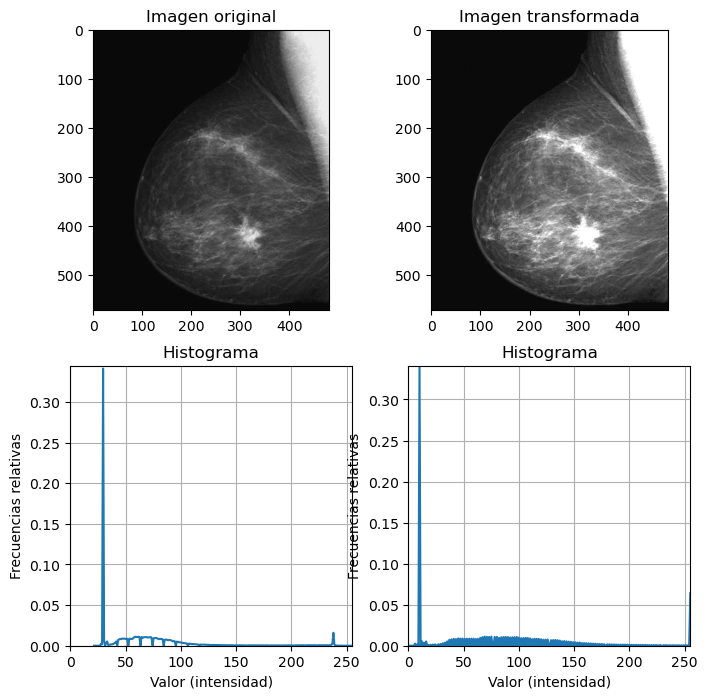

In [163]:
#Visualización de la corrección aplicada
img_mamografia_hist, bins_mamografia = exposure.histogram(img_mamografia_float, normalize=True)

plt.figure(figsize=(8, 8))

plt.subplot(221)
plt.imshow(img_mamografia, cmap='gray')
plt.title('Imagen original')

plt.subplot(223)
plt.plot(bins_mamografia, img_mamografia_hist)
plt.axis([0,255, 0, 1.01*img_mamografia_hist.max()])
plt.title('Histograma')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencias relativas')
plt.grid()


img_mamografia_hist, bins_mamografia = exposure.histogram(img_mamografia_transf, normalize=True)

plt.subplot(222)
plt.imshow(img_mamografia_transf, cmap='gray')
plt.title('Imagen transformada')

plt.subplot(224)
plt.plot(bins_mamografia, img_mamografia_hist)
plt.axis([0,255, 0, img_mamografia_hist.max()])
plt.title('Histograma')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencias relativas')
plt.grid()

La transformación que se ha aplicado ha establecido el nivel de negro en 25 y el de blanco en 150. De esta forma se puede apreciar con mayor precisión los valores medios que antes estaban muy concentrados entre 50 y 100. Además, el color del fondo oscuro se ha llevado hasta el negro.

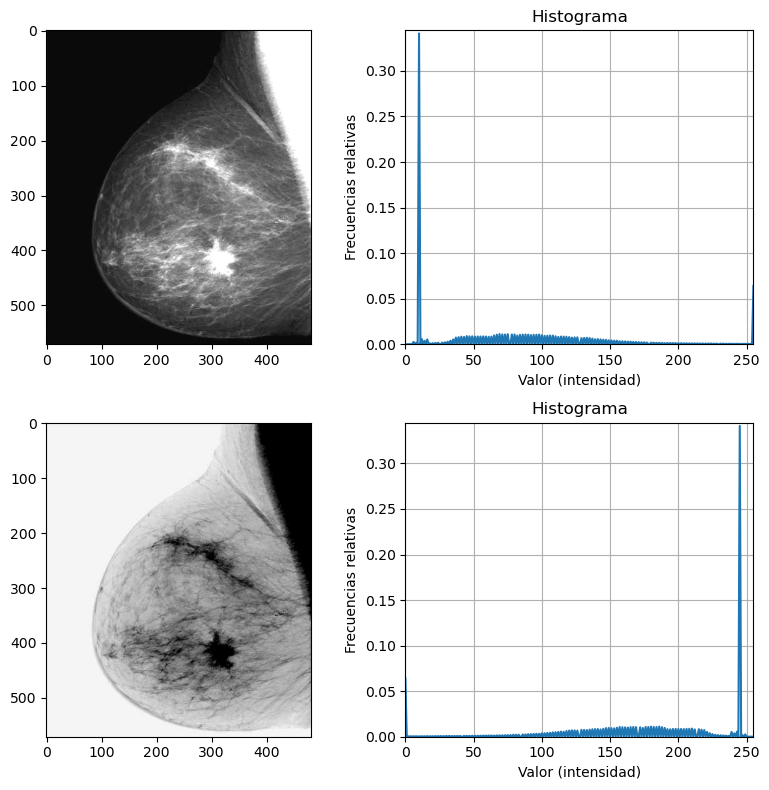

In [164]:
#Apartado 4)

img_mamografia_inv = util.invert(img_mamografia_float2)

img_mamografia_inv_hist, bins_mamografia_inv = exposure.histogram(img_mamografia_inv, normalize=True)

plt.figure(figsize=(8, 8))

plt.subplot(221)
plt.imshow(img_mamografia_float2, cmap='gray')

plt.subplot(222)
plt.plot(bins_mamografia, img_mamografia_hist)
plt.axis([0,255, 0, 1.01*img_mamografia_hist.max()])
plt.title('Histograma')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencias relativas')
plt.grid()

plt.subplot(223)
plt.imshow(img_mamografia_inv, cmap='gray')

plt.subplot(224)
plt.plot(bins_mamografia, img_mamografia_inv_hist)
plt.axis([0,255, 0, 1.01*img_mamografia_hist.max()])
plt.title('Histograma')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencias relativas')
plt.grid()

plt.tight_layout()

En las imágenes médicas se recomienda aplicar el negativo, para poder visualizar mejor los pequeños detalles de la imagen.

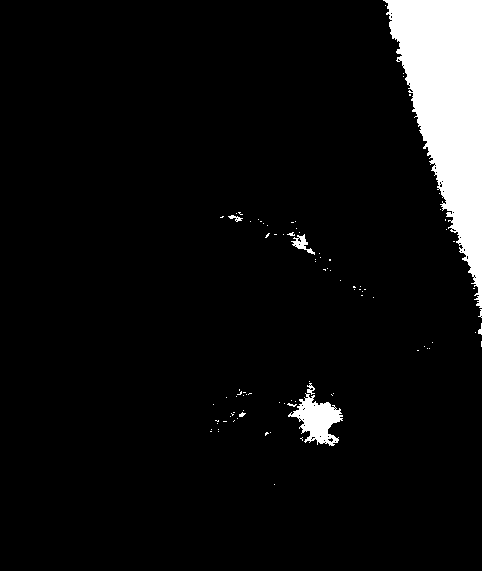

In [165]:
#Apartado 6
Image.fromarray(img_mamografia_transf>250)

Se ha aplicado una máscara para extraer las partes de la imagen en las que el nivel de los píxeles supera los 250, es decir los blancos.

### Imagen 2: Estudio Esquelético

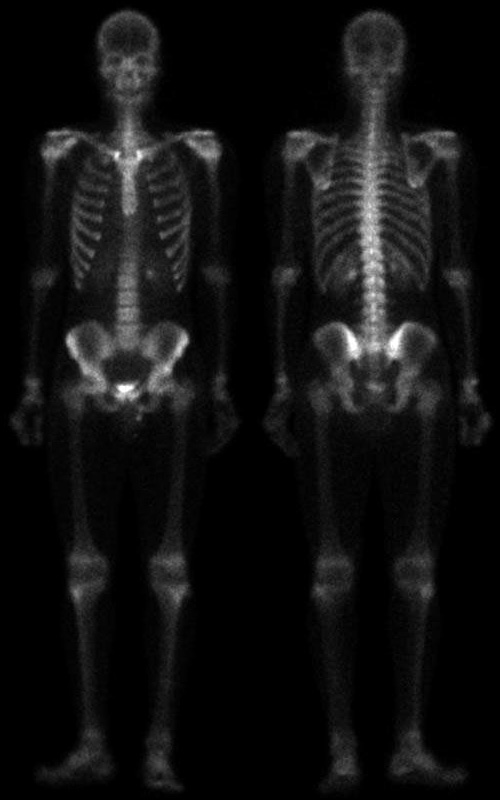

In [166]:
#Apartado 1)
file_esqueleto = 'images/skeleton.tif'
img_esqueleto  = Image.open(file_esqueleto)
display(img_esqueleto)

In [167]:
#Apartado 2)a.
img_esqueleto_float = np.asarray(img_esqueleto, dtype = 'float')

# Principales estadísticos
print('Valor mínimo de imagen esqueleto:', img_esqueleto_float.min())
print('Valor máximo de imagen esqueleto:', img_esqueleto_float.max())
print('Rango de esqueleto:', img_esqueleto_float.max() - img_esqueleto_float.min())
print('Media de esqueleto:', img_esqueleto_float.mean())
print('Desviación típica de esqueleto:', img_esqueleto_float.std())
print('Varianza de esqueleto:', img_esqueleto_float.var())
print('Coeficiente de variación de esqueleto:', img_esqueleto_float.std() / img_esqueleto_float.mean())
img_esqueleto_q = np.quantile(img_esqueleto, (0.25, 0.5, 0.75))
print('1er cuantil de esqueleto (Q1): ', img_esqueleto_q[0], '\nMediana de esqueleto (Q2): ', img_esqueleto_q[1], '\n3er cuantil de esqueleto (Q3): ', img_esqueleto_q[2],
     '\nRango intercuantil de esqueleto (IQR): ', img_esqueleto_q[2]-img_esqueleto_q[0], '\nRango medio intercuantil de esqueleto: ', (img_esqueleto_q[0]+img_esqueleto_q[2])/2)


Valor mínimo de imagen esqueleto: 0.0
Valor máximo de imagen esqueleto: 255.0
Rango de esqueleto: 255.0
Media de esqueleto: 17.2210775
Desviación típica de esqueleto: 29.338301113714703
Varianza de esqueleto: 860.7359122389935
Coeficiente de variación de esqueleto: 1.7036274944883503
1er cuantil de esqueleto (Q1):  0.0 
Mediana de esqueleto (Q2):  4.0 
3er cuantil de esqueleto (Q3):  22.0 
Rango intercuantil de esqueleto (IQR):  22.0 
Rango medio intercuantil de esqueleto:  11.0


En la imagen del esqueleto sí se está aprovechando toda la escala de grises (mínimo en 0 y máximo en 255). No obstante, la media está en 17.22, lo que indica que los valores se concentran en los niveles bajos. Esta idea la refuerzan otros estadísticos como la mediana (4.0). Esto se debe a la gran cantidad de fondo oscuro.

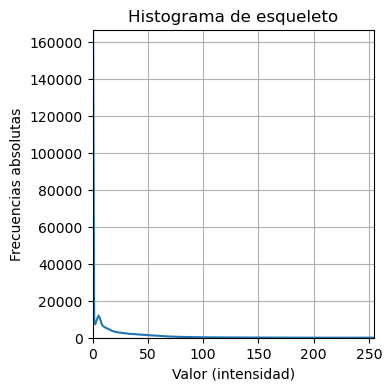

In [168]:
#Apartado 2)b.
# Histograma
plt.figure(figsize=(8, 4))

img_esqueleto_hist, bins_esqueleto = exposure.histogram(img_esqueleto_float, normalize=False)
plt.subplot(121)
plt.plot(bins_esqueleto, img_esqueleto_hist)
plt.axis([0,255, 0, 1.01*img_esqueleto_hist.max()])
plt.title('Histograma de esqueleto')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencias absolutas')
plt.grid()

Aquí se aprecia esa gran concentración en el entorno de los valores más bajos.

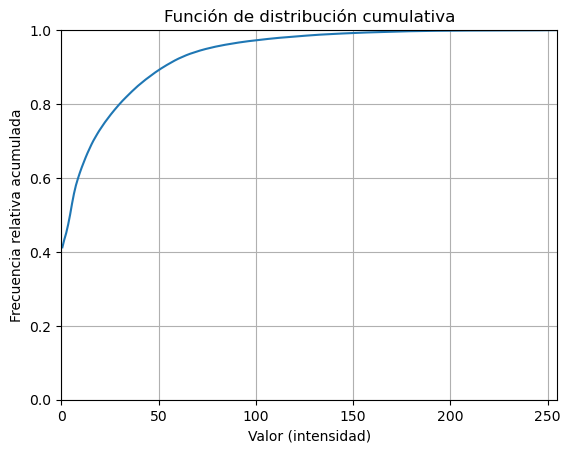

In [169]:
#Apartado 2)b.
# Función de distribución cumulativa
img_esqueleto_cdf, bins_esqueleto_cdf = exposure.cumulative_distribution(img_esqueleto_float)

plt.plot(bins_esqueleto_cdf, img_esqueleto_cdf)
plt.axis([0,255, 0, 1])
plt.title('Función de distribución cumulativa')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencia relativa acumulada')
plt.grid()

Se puede decir que el 40% de la imagen es fondo completamente negro (0).

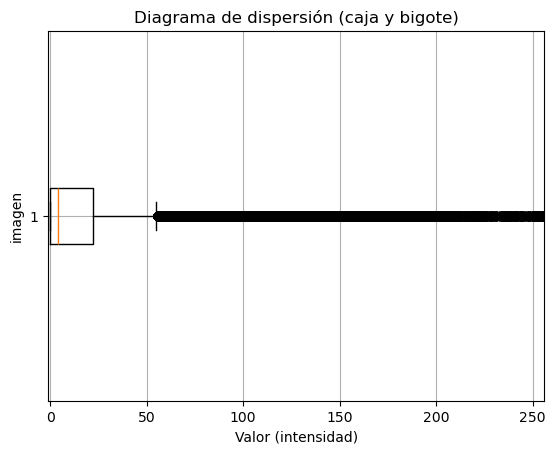

In [170]:
#Apartado 2)c.
# Diagrama de dispersión (caja bigote)
plt.boxplot(img_esqueleto_float.flatten(), vert=False)
plt.xlim([-1, 256])
plt.title('Diagrama de dispersión (caja y bigote)')
plt.xlabel('Valor (intensidad)')
plt.ylabel('imagen')
plt.grid()

Al igual que en la imagen de la mamografía, pero de forma más pronunciada esta vez, la gran concentración en los valores del negro, por la gran cantidad de fondo oscuro de la imagen, hace que aparezcan valores atípicos en los píxeles que se alejen de las tonalidades oscuras del gris.

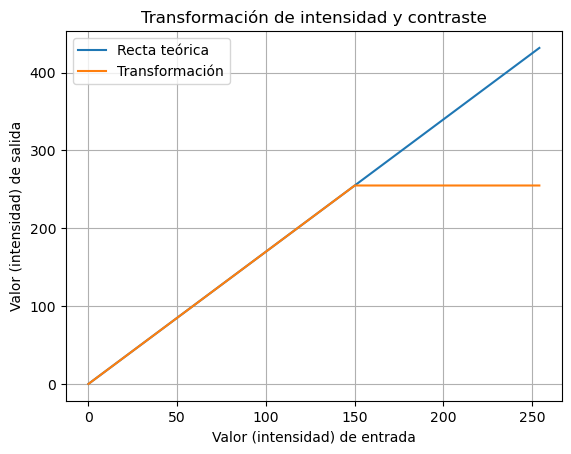

In [171]:
#Apartado 3)

#Definición de la transformación
Mi = 255

Bl = 0
Wl = 150

L = (Bl + Wl)/2
W = Wl - Bl

m = Mi/W
b = -Mi*(L/W - 0.5)

# Representación de la transformación

x = np.arange((min(Bl, 0)), max(Wl, Mi))
y = m*x +b

y_transf = y.copy()
y_transf[y_transf<0] = 0
y_transf[y_transf>Mi] = Mi

plt.plot(x,y, label='Recta teórica')
plt.plot(x, y_transf, label='Transformación')

plt.legend()
plt.title('Transformación de intensidad y contraste')
plt.xlabel('Valor (intensidad) de entrada')
plt.ylabel('Valor (intensidad) de salida')
plt.grid()

In [172]:
img_esqueleto_float2 = util.img_as_float(img_esqueleto)*Mi

img_esqueleto_float2 = img_esqueleto_float2*m + b
img_esqueleto_float2[img_esqueleto_float2<0]  = 0
img_esqueleto_float2[img_esqueleto_float2>Mi] = Mi

img_esqueleto_transf = util.img_as_ubyte(img_esqueleto_float2/Mi)

print('Tipo de datos: ', img_esqueleto_transf.dtype)
print('Tamaño de imagen (filas, columnas): ', img_esqueleto_transf.shape)
print('Número de píxels: ', img_esqueleto_transf.size)
print('Imagen: \nValor mínimo: ', img_esqueleto_transf.min(), '\tValor máximo: ', img_esqueleto_transf.max())
print('Valor mediano: ', img_esqueleto_transf.mean())

Tipo de datos:  uint8
Tamaño de imagen (filas, columnas):  (800, 500)
Número de píxels:  400000
Imagen: 
Valor mínimo:  0 	Valor máximo:  255
Valor mediano:  28.8564175


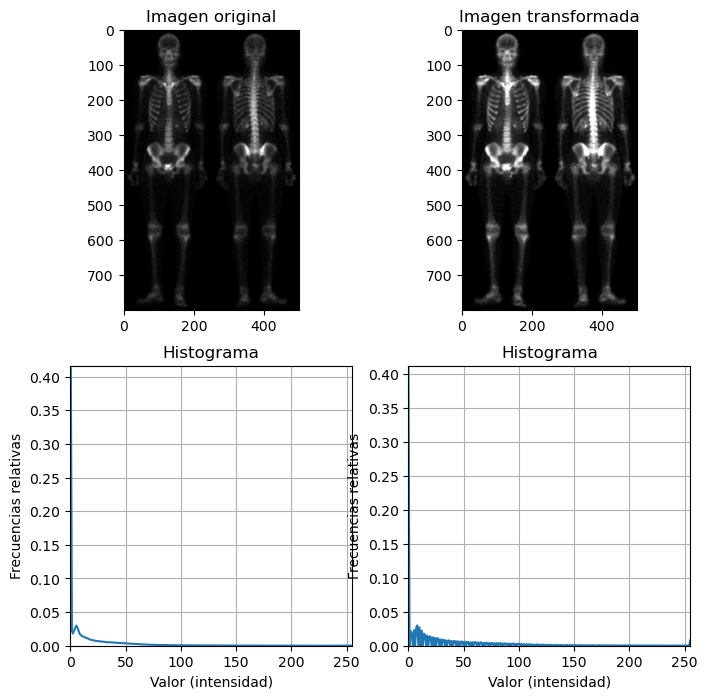

In [173]:
#Visualización de la corrección aplicada
img_esqueleto_hist, bins_esqueleto = exposure.histogram(img_esqueleto_float, normalize=True)

plt.figure(figsize=(8, 8))

plt.subplot(221)
plt.imshow(img_esqueleto, cmap='gray')
plt.title('Imagen original')

plt.subplot(223)
plt.plot(bins_esqueleto, img_esqueleto_hist)
plt.axis([0,255, 0, 1.01*img_esqueleto_hist.max()])
plt.title('Histograma')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencias relativas')
plt.grid()


img_esqueleto_hist, bins_esqueleto = exposure.histogram(img_esqueleto_transf, normalize=True)

plt.subplot(222)
plt.imshow(img_esqueleto_transf, cmap='gray')
plt.title('Imagen transformada')

plt.subplot(224)
plt.plot(bins_esqueleto, img_esqueleto_hist)
plt.axis([0,255, 0, img_esqueleto_hist.max()])
plt.title('Histograma')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencias relativas')
plt.grid()

Se ha establecido el nivel de blanco en 150, de forma que se aprovecha mejor la escala de grises, pues la mayoría de valores se encontraban concentrados por debajo de este valor y apenas se podía apreciar diferencias entre ellos.

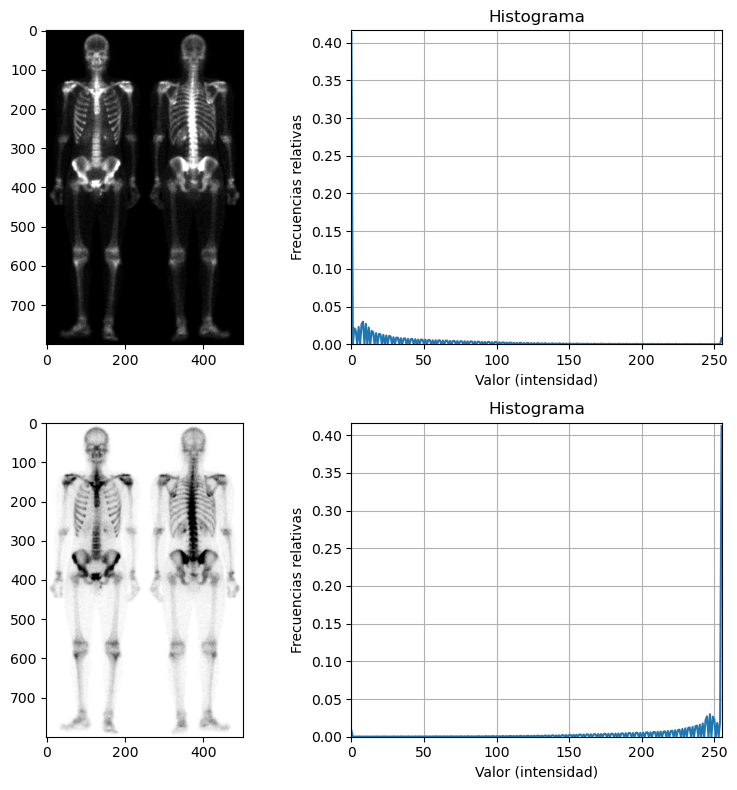

In [174]:
#Apartado 4)

img_esqueleto_inv = util.invert(img_esqueleto_float2)

img_esqueleto_inv_hist, bins_esqueleto_inv = exposure.histogram(img_esqueleto_inv, normalize=True)

plt.figure(figsize=(8, 8))

plt.subplot(221)
plt.imshow(img_esqueleto_float2, cmap='gray')

plt.subplot(222)
plt.plot(bins_esqueleto, img_esqueleto_hist)
plt.axis([0,255, 0, 1.01*img_esqueleto_hist.max()])
plt.title('Histograma')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencias relativas')
plt.grid()

plt.subplot(223)
plt.imshow(img_esqueleto_inv, cmap='gray')

plt.subplot(224)
plt.plot(bins_esqueleto, img_esqueleto_inv_hist)
plt.axis([0,255, 0, 1.01*img_esqueleto_hist.max()])
plt.title('Histograma')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencias relativas')
plt.grid()

plt.tight_layout()

En las imágenes médicas se recomienda aplicar el negativo, para poder visualizar mejor los pequeños detalles de la imagen.

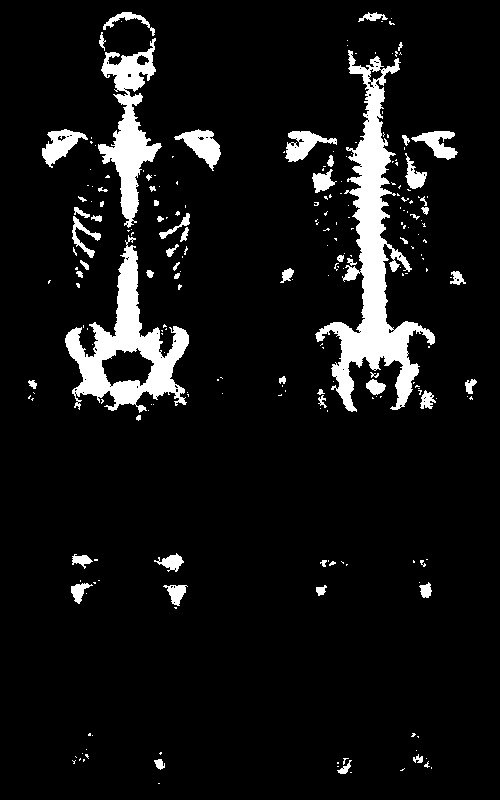

In [175]:
#Apartado 6
Image.fromarray(img_esqueleto_transf>100)

Con esta máscara se puede extraer todas las zonas en las que hay "mayor concentración de hueso" en el esqueleto humano.

### Imagen 3: Imagen Aérea Ciudad

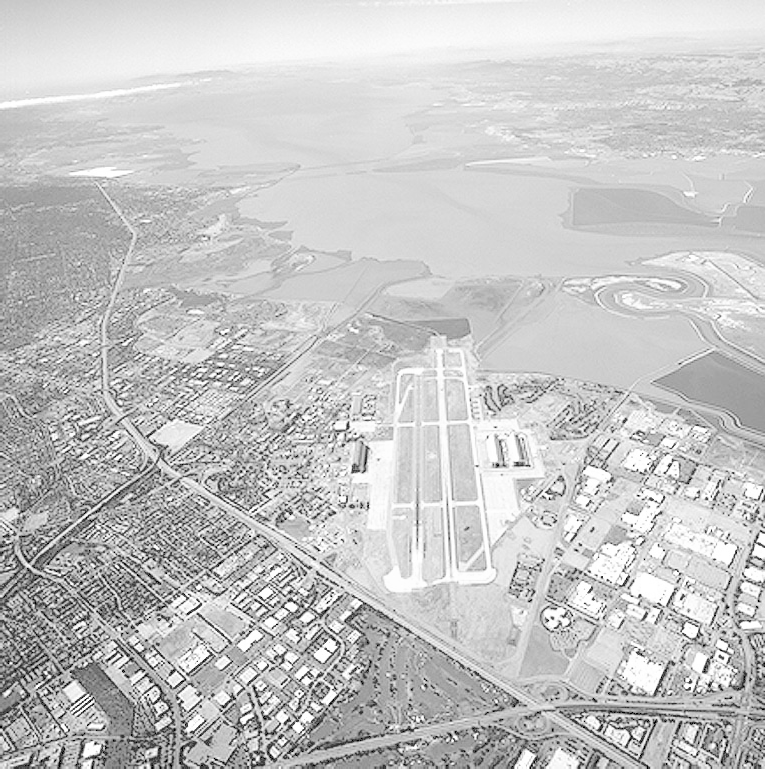

In [176]:
#Apartado 1)
file_ciudad = 'images/washed_aerial.tif'
img_ciudad  = Image.open(file_ciudad)
display(img_ciudad)

In [177]:
#Apartado 2)a.
img_ciudad_float = np.asarray(img_ciudad, dtype = 'float')

# Principales estadísticos
print('Valor mínimo de imagen ciudad:', img_ciudad_float.min())
print('Valor máximo de imagen ciudad:', img_ciudad_float.max())
print('Rango de ciudad:', img_ciudad_float.max() - img_ciudad_float.min())
print('Media de ciudad:', img_ciudad_float.mean())
print('Desviación típica de ciudad:', img_ciudad_float.std())
print('Varianza de ciudad:', img_ciudad_float.var())
print('Coeficiente de variación de ciudad:', img_ciudad_float.std() / img_ciudad_float.mean())
img_ciudad_q = np.quantile(img_ciudad, (0.25, 0.5, 0.75))
print('1er cuantil de ciudad (Q1): ', img_ciudad_q[0], '\nMediana de ciudad (Q2): ', img_ciudad_q[1], '\n3er cuantil de ciudad (Q3): ', img_ciudad_q[2],
     '\nRango intercuantil de ciudad (IQR): ', img_ciudad_q[2]-img_ciudad_q[0], '\nRango medio intercuantil de ciudad: ', (img_ciudad_q[0]+img_ciudad_q[2])/2)


Valor mínimo de imagen ciudad: 0.0
Valor máximo de imagen ciudad: 255.0
Rango de ciudad: 255.0
Media de ciudad: 197.1243155953322
Desviación típica de ciudad: 40.880559425295594
Varianza de ciudad: 1671.2201389251243
Coeficiente de variación de ciudad: 0.20738466130793062
1er cuantil de ciudad (Q1):  181.0 
Mediana de ciudad (Q2):  208.0 
3er cuantil de ciudad (Q3):  222.0 
Rango intercuantil de ciudad (IQR):  41.0 
Rango medio intercuantil de ciudad:  201.5


Es una imagen que utiliza toda la escala de grises, de 0 a 255, pero que no tiene un buen contraste, lo que hace que se vea todo en tonalidades grises medias, sin zonas muy oscuras ni muy claras. Esto se aprecia, por ejemplo, en la proximidad de los cuantiles (181, 208 y 222).

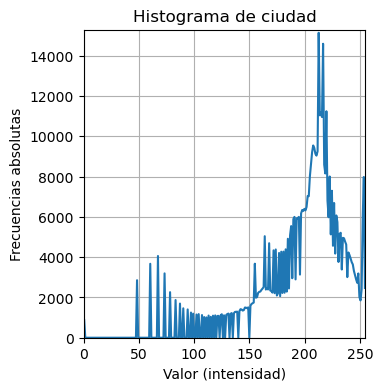

In [178]:
#Apartado 2)b.
# Histograma
plt.figure(figsize=(8, 4))

img_ciudad_hist, bins_ciudad = exposure.histogram(img_ciudad_float, normalize=False)
plt.subplot(121)
plt.plot(bins_ciudad, img_ciudad_hist)
plt.axis([0,255, 0, 1.01*img_ciudad_hist.max()])
plt.title('Histograma de ciudad')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencias absolutas')
plt.grid()

En el histograma se aprecia cómo, a pesar de haber píxeles de negro total, realmente los que son prácticamente los valores más oscuros de la imagen se agrupan cerca del valor de 50. Destaca también que hay un gran pico en el entorno del valor de 210.

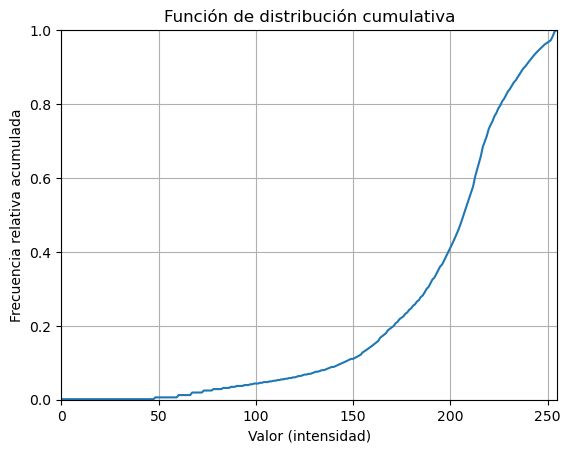

In [179]:
#Apartado 2)b.
# Función de distribución cumulativa
img_ciudad_cdf, bins_ciudad_cdf = exposure.cumulative_distribution(img_ciudad_float)

plt.plot(bins_ciudad_cdf, img_ciudad_cdf)
plt.axis([0,255, 0, 1])
plt.title('Función de distribución cumulativa')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencia relativa acumulada')
plt.grid()

En la distribución cumulativa también se aprecia que hasta el valor de 50, no hay casi píxeles. Por lo que los valores oscuros están poco aprovechados.

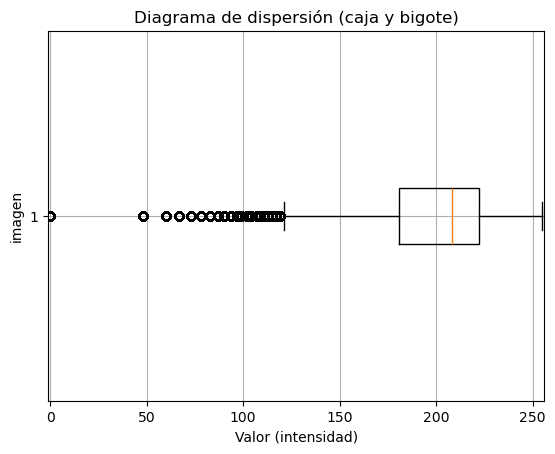

In [180]:
#Apartado 2)c.
# Diagrama de dispersión (caja bigote)
plt.boxplot(img_ciudad_float.flatten(), vert=False)
plt.xlim([-1, 256])
plt.title('Diagrama de dispersión (caja y bigote)')
plt.xlabel('Valor (intensidad)')
plt.ylabel('imagen')
plt.grid()

A diferencia de las dos imágenes anteriores, ahora los valores atípicos aparecen en los tonos oscuros de gris.

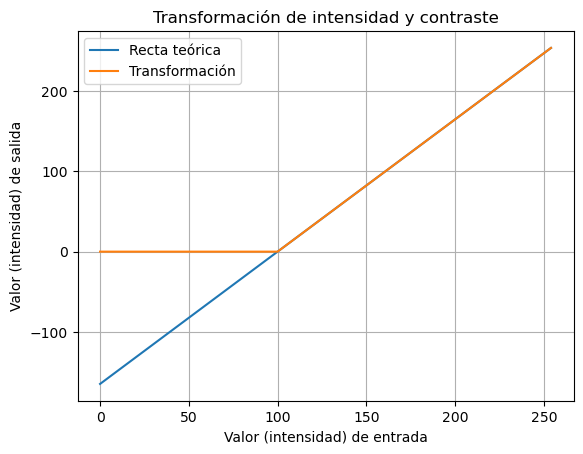

In [181]:
#Apartado 3)

#Definición de la transformación
Mi = 255

#Bl = 45 #Este es el primer valor con el que realicé la corrección, pero mirando el resultado y el diagrama de caja y bigotes, puede resultar más conveniente poner un valor mayor (para obtener mayor contraste en los grises medios y reducir los outlayers que se ven en el diagrama de dispersión).
Bl = 100
Wl = 255

L = (Bl + Wl)/2
W = Wl - Bl

m = Mi/W
b = -Mi*(L/W - 0.5)

# Representación de la transformación

x = np.arange((min(Bl, 0)), max(Wl, Mi))
y = m*x +b

y_transf = y.copy()
y_transf[y_transf<0] = 0
y_transf[y_transf>Mi] = Mi

plt.plot(x,y, label='Recta teórica')
plt.plot(x, y_transf, label='Transformación')

plt.legend()
plt.title('Transformación de intensidad y contraste')
plt.xlabel('Valor (intensidad) de entrada')
plt.ylabel('Valor (intensidad) de salida')
plt.grid()

In [182]:
img_ciudad_float2 = util.img_as_float(img_ciudad)*Mi

img_ciudad_float2 = img_ciudad_float2*m + b
img_ciudad_float2[img_ciudad_float2<0]  = 0
img_ciudad_float2[img_ciudad_float2>Mi] = Mi

img_ciudad_transf = util.img_as_ubyte(img_ciudad_float2/Mi)

print('Tipo de datos: ', img_ciudad_transf.dtype)
print('Tamaño de imagen (filas, columnas): ', img_ciudad_transf.shape)
print('Número de píxels: ', img_ciudad_transf.size)
print('Imagen: \nValor mínimo: ', img_ciudad_transf.min(), '\tValor máximo: ', img_ciudad_transf.max())
print('Valor mediano: ', img_ciudad_transf.mean())

Tipo de datos:  uint8
Tamaño de imagen (filas, columnas):  (769, 765)
Número de píxels:  588285
Imagen: 
Valor mínimo:  0 	Valor máximo:  255
Valor mediano:  161.83045802629678


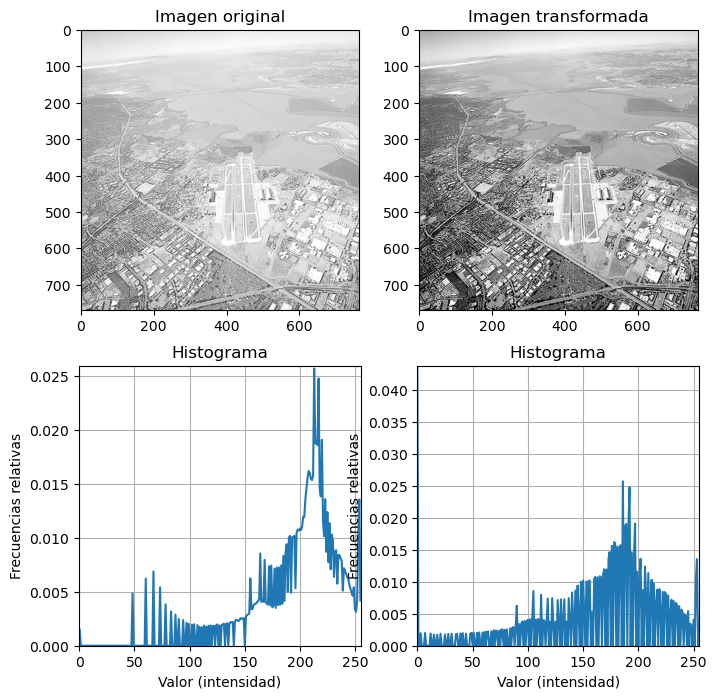

In [183]:
#Visualización de la corrección aplicada
img_ciudad_hist, bins_ciudad = exposure.histogram(img_ciudad_float, normalize=True)

plt.figure(figsize=(8, 8))

plt.subplot(221)
plt.imshow(img_ciudad, cmap='gray')
plt.title('Imagen original')

plt.subplot(223)
plt.plot(bins_ciudad, img_ciudad_hist)
plt.axis([0,255, 0, 1.01*img_ciudad_hist.max()])
plt.title('Histograma')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencias relativas')
plt.grid()


img_ciudad_hist, bins_ciudad = exposure.histogram(img_ciudad_transf, normalize=True)

plt.subplot(222)
plt.imshow(img_ciudad_transf, cmap='gray')
plt.title('Imagen transformada')

plt.subplot(224)
plt.plot(bins_ciudad, img_ciudad_hist)
plt.axis([0,255, 0, img_ciudad_hist.max()])
plt.title('Histograma')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencias relativas')
plt.grid()

En la imagen se aprecia que el contraste ha mejorado considerablemente, diferenciándose mucho mejor los elementos de la ciudad.

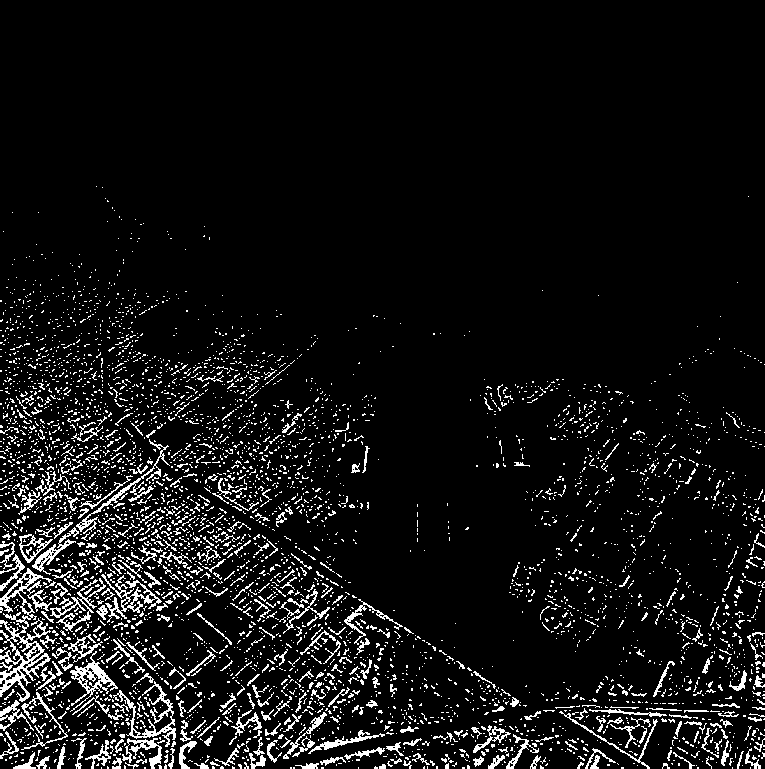

In [184]:
#Apartado 6
Image.fromarray(img_ciudad_transf<50)

Aplicando una máscara con los valores inferiores a 50, se pueden extraer las carreteras de la ciudad y algunos contornos de las edificaciones.

### Imagen 4: Imagen Microscópica Polen

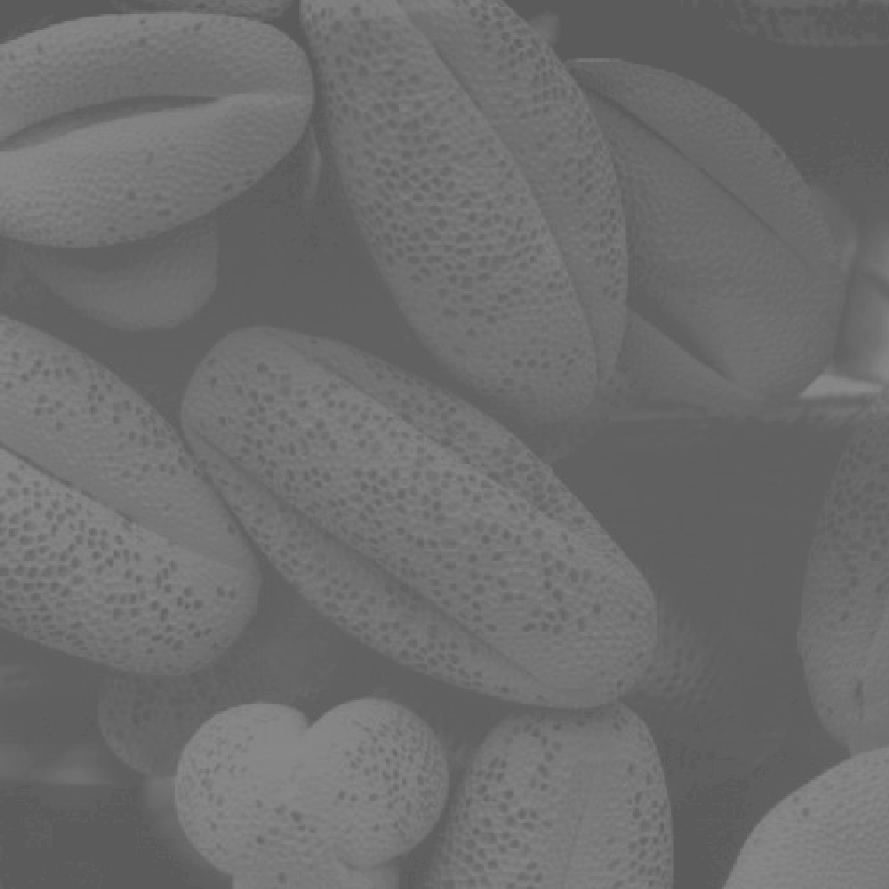

(ancho, alto) = (889, 889)


In [185]:
#Apartado 1)
file_polen = 'images/washed_pollen.tif'
img_polen  = Image.open(file_polen)
display(img_polen)
print('(ancho, alto) =', img_polen.size)

In [186]:
#Apartado 2)a.
img_polen_float = np.asarray(img_polen, dtype = 'float')

# Principales estadísticos
print('Valor mínimo de imagen polen:', img_polen_float.min())
print('Valor máximo de imagen polen:', img_polen_float.max())
print('Rango de polen:', img_polen_float.max() - img_polen_float.min())
print('Media de polen:', img_polen_float.mean())
print('Desviación típica de polen:', img_polen_float.std())
print('Varianza de polen:', img_polen_float.var())
print('Coeficiente de variación de polen:', img_polen_float.std() / img_polen_float.mean())
img_polen_q = np.quantile(img_polen, (0.25, 0.5, 0.75))
print('1er cuantil de polen (Q1): ', img_polen_q[0], '\nMediana de polen (Q2): ', img_polen_q[1], '\n3er cuantil de polen (Q3): ', img_polen_q[2],
     '\nRango intercuantil de polen (IQR): ', img_polen_q[2]-img_polen_q[0], '\nRango medio intercuantil de polen: ', (img_polen_q[0]+img_polen_q[2])/2)


Valor mínimo de imagen polen: 91.0
Valor máximo de imagen polen: 138.0
Rango de polen: 47.0
Media de polen: 109.08651168322744
Desviación típica de polen: 11.49156306034834
Varianza de polen: 132.05602156996252
Coeficiente de variación de polen: 0.10534357440742348
1er cuantil de polen (Q1):  98.0 
Mediana de polen (Q2):  110.0 
3er cuantil de polen (Q3):  118.0 
Rango intercuantil de polen (IQR):  20.0 
Rango medio intercuantil de polen:  108.0


La imagen del polen no está utilizando toda la escala de grises. El rango es de 47, mientras que la escala es de 255.

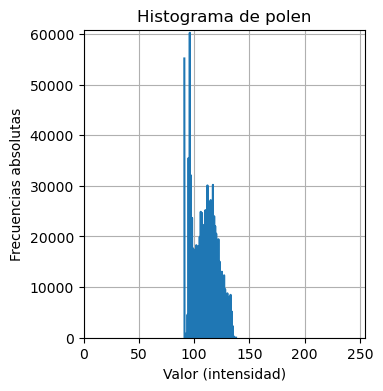

In [187]:
#Apartado 2)b.
# Histograma
plt.figure(figsize=(8, 4))

img_polen_hist, bins_polen = exposure.histogram(img_polen_float, normalize=False)
plt.subplot(121)
plt.plot(bins_polen, img_polen_hist)
plt.axis([0,255, 0, 1.01*img_polen_hist.max()])
plt.title('Histograma de polen')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencias absolutas')
plt.grid()

Lo comentado anteriormente es visible en el histograma: solo existen valores entre 91 y 138. Cabe destacar también unos picos que hay por debajo de 100, que pueden corresponderse con el fondo de la imagen.

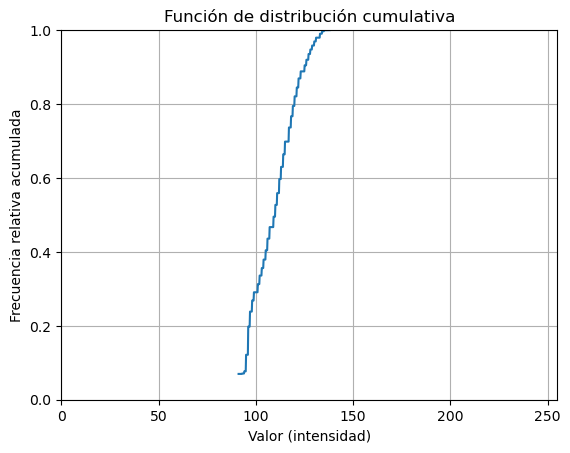

In [188]:
#Apartado 2)b.
# Función de distribución cumulativa
img_polen_cdf, bins_polen_cdf = exposure.cumulative_distribution(img_polen_float)

plt.plot(bins_polen_cdf, img_polen_cdf)
plt.axis([0,255, 0, 1])
plt.title('Función de distribución cumulativa')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencia relativa acumulada')
plt.grid()

La función de distribución cumulativa tiene una gran pendiente, debido a la concentración de los valores en los grises medios.

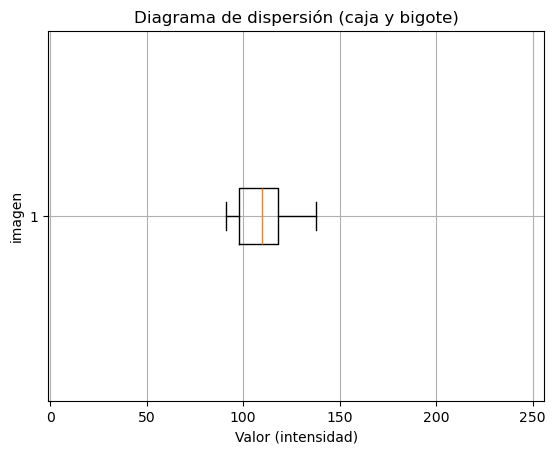

In [189]:
#Apartado 2)c.
# Diagrama de dispersión (caja bigote)
plt.boxplot(img_polen_float.flatten(), vert=False)
plt.xlim([-1, 256])
plt.title('Diagrama de dispersión (caja y bigote)')
plt.xlabel('Valor (intensidad)')
plt.ylabel('imagen')
plt.grid()

No hay valores atípicos, debido a que todos los píxeles están muy concentrados entorno a la mediana.

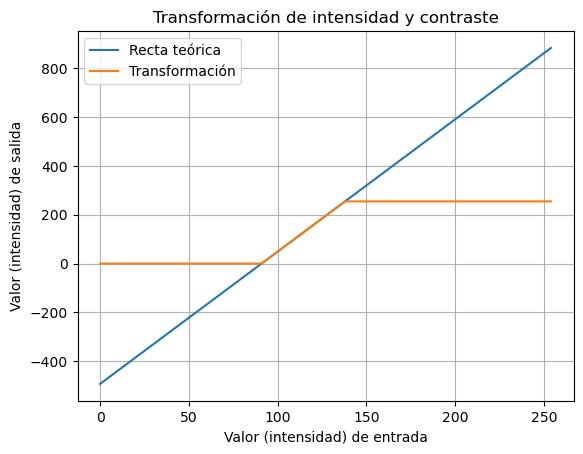

In [190]:
#Apartado 3)

#Definición de la transformación
Mi = 255

#En este caso, dada la concentración de los valores, pongo como nivel de negro y de blanco, el máximo y el mínimo visto en el apartado 2)a.
Bl = 91
Wl = 138

L = (Bl + Wl)/2
W = Wl - Bl

m = Mi/W
b = -Mi*(L/W - 0.5)

# Representación de la transformación

x = np.arange((min(Bl, 0)), max(Wl, Mi))
y = m*x +b

y_transf = y.copy()
y_transf[y_transf<0] = 0
y_transf[y_transf>Mi] = Mi

plt.plot(x,y, label='Recta teórica')
plt.plot(x, y_transf, label='Transformación')

plt.legend()
plt.title('Transformación de intensidad y contraste')
plt.xlabel('Valor (intensidad) de entrada')
plt.ylabel('Valor (intensidad) de salida')
plt.grid()

In [191]:
img_polen_float2 = util.img_as_float(img_polen)*Mi

img_polen_float2 = img_polen_float2*m + b
img_polen_float2[img_polen_float2<0]  = 0
img_polen_float2[img_polen_float2>Mi] = Mi

img_polen_transf = util.img_as_ubyte(img_polen_float2/Mi)

print('Tipo de datos: ', img_polen_transf.dtype)
print('Tamaño de imagen (filas, columnas): ', img_polen_transf.shape)
print('Número de píxels: ', img_polen_transf.size)
print('Imagen: \nValor mínimo: ', img_polen_transf.min(), '\tValor máximo: ', img_polen_transf.max())
print('Valor mediano: ', img_polen_transf.mean())

Tipo de datos:  uint8
Tamaño de imagen (filas, columnas):  (889, 889)
Número de píxels:  790321
Imagen: 
Valor mínimo:  0 	Valor máximo:  255
Valor mediano:  98.13812615380333


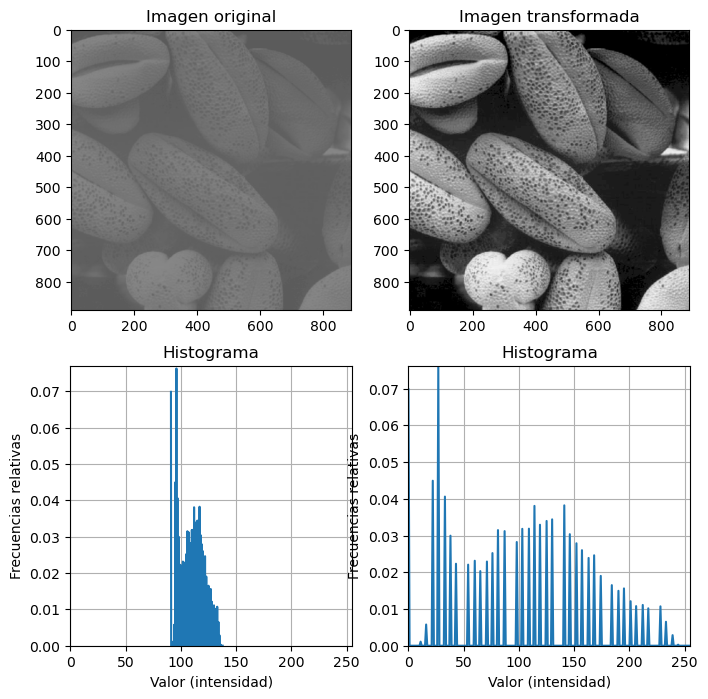

In [192]:
#Visualización de la corrección aplicada
img_polen_hist, bins_polen = exposure.histogram(img_polen_float, normalize=True)

plt.figure(figsize=(8, 8))

img_polen_float[0,888]=255
img_polen_float[888,0]=0
img_polen2 = Image.fromarray(img_polen_float)
plt.subplot(221)
plt.imshow(img_polen2, cmap='gray')
plt.title('Imagen original')

plt.subplot(223)
plt.plot(bins_polen, img_polen_hist)
plt.axis([0,255, 0, 1.01*img_polen_hist.max()])
plt.title('Histograma')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencias relativas')
plt.grid()


img_polen_hist, bins_polen = exposure.histogram(img_polen_transf, normalize=True)

plt.subplot(222)
plt.imshow(img_polen_transf, cmap='gray')
plt.title('Imagen transformada')

plt.subplot(224)
plt.plot(bins_polen, img_polen_hist)
plt.axis([0,255, 0, img_polen_hist.max()])
plt.title('Histograma')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencias relativas')
plt.grid()

Para esta transformación solo ha sido necesario ubicar el nivel de negro en el mínimo que tenía la imagen y el valor de blanco en el máximo, consiguiendo así un gran cambio en el contraste, permitiendo una visualización de la imagen mucho más detallada.

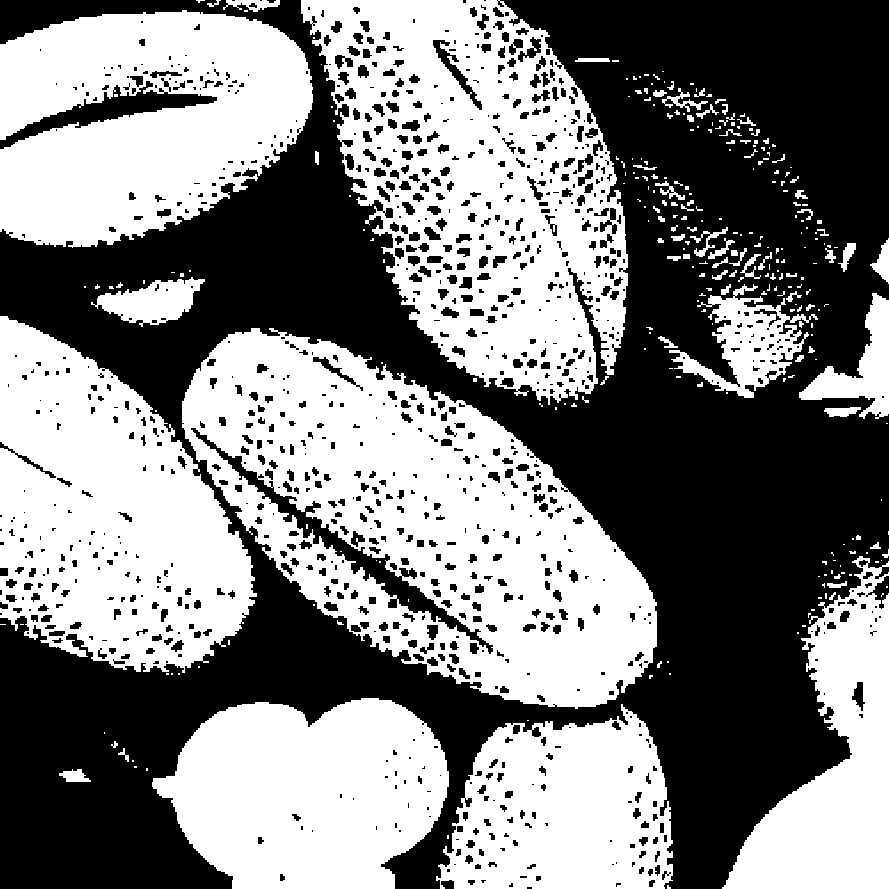

In [193]:
#Apartado 6
Image.fromarray(img_polen_transf>100)

Al aplicar una máscara con los píxeles por encima de 100 se puede extraer los granos de polen más brillantes de la imagen.

### Imagen 5: Perro Boston

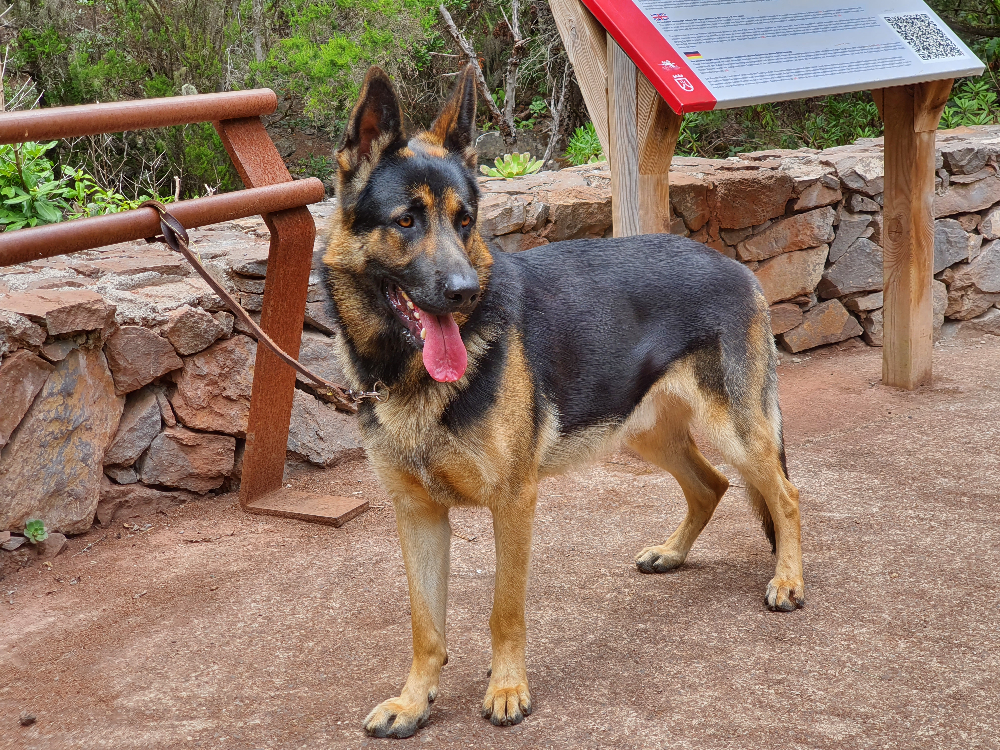

In [194]:
#Apartado 1)
file_boston = 'images/PerroBoston.jpg'
img_boston  = Image.open(file_boston)
display(img_boston)

In [195]:
#Apartado 2)a.
img_boston_float = np.asarray(img_boston, dtype = 'float')

# Principales estadísticos
print('Valor mínimo de imagen Boston:', img_boston_float.min())
print('Valor máximo de imagen Boston:', img_boston_float.max())
print('Rango de Boston:', img_boston_float.max() - img_boston_float.min())
print('Media de Boston:', img_boston_float.mean())
print('Desviación típica de Boston:', img_boston_float.std())
print('Varianza de Boston:', img_boston_float.var())
print('Coeficiente de variación de Boston:', img_boston_float.std() / img_boston_float.mean())
img_boston_q = np.quantile(img_boston, (0.25, 0.5, 0.75))
print('1er cuantil de Boston (Q1): ', img_boston_q[0], '\nMediana de Boston (Q2): ', img_boston_q[1], '\n3er cuantil de Boston (Q3): ', img_boston_q[2],
     '\nRango intercuantil de Boston (IQR): ', img_boston_q[2]-img_boston_q[0], '\nRango medio intercuantil de Boston: ', (img_boston_q[0]+img_boston_q[2])/2)


Valor mínimo de imagen Boston: 0.0
Valor máximo de imagen Boston: 255.0
Rango de Boston: 255.0
Media de Boston: 123.0042705369828
Desviación típica de Boston: 53.45669732884099
Varianza de Boston: 2857.618489307315
Coeficiente de variación de Boston: 0.4345922063963507
1er cuantil de Boston (Q1):  84.0 
Mediana de Boston (Q2):  126.0 
3er cuantil de Boston (Q3):  163.0 
Rango intercuantil de Boston (IQR):  79.0 
Rango medio intercuantil de Boston:  123.5


La imagen aprovecha todo el rango disponible entre 0 y 255. Además, la media y la mediana están en el entorno de 120, lo cual indica que existe cierto balance entre los valores altos y bajos.

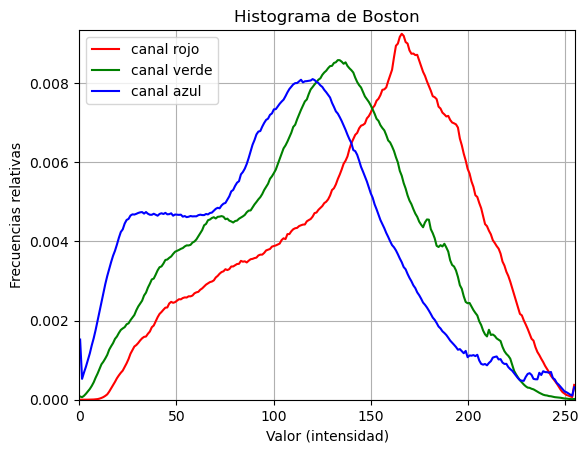

In [196]:
#Apartado 2)b.
# Histograma
img_boston_hist, bins = exposure.histogram(img_boston_float, channel_axis=2, normalize=True)
M = img_boston_hist.max()

plt.plot(bins, img_boston_hist[0,:],'r', label='canal rojo')
plt.plot(bins, img_boston_hist[1,:],'g', label='canal verde')
plt.plot(bins, img_boston_hist[2,:],'b', label='canal azul')

plt.axis([0,255, 0, 1.01*img_boston_hist.max()])
plt.legend()
plt.title('Histograma de Boston')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencias relativas')
plt.grid()

En el histograma se puede apreciar que los tres colores tienen una presencia significativa. El rojo destaca por encima de los demás, con una mayor concentración en niveles altos. Por su parte, el azul es el que presenta un pico en un valor de intensidad menor y el que tiene mayor presencia en las intensidades bajas.

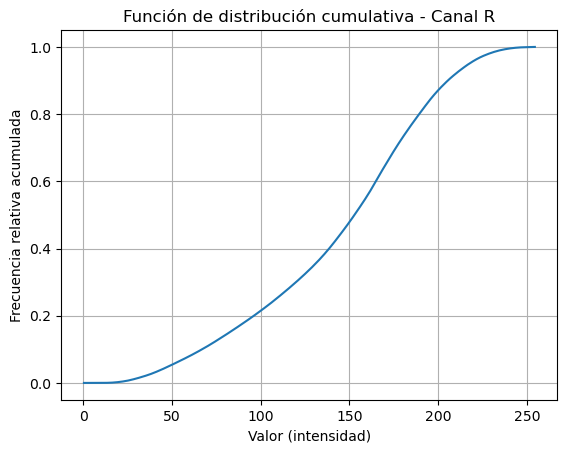

In [197]:
#Apartado 2)b.

R, G, B = img_boston_float[:,:,0], img_boston_float[:,:,1], img_boston_float[:,:,2]

# Función de distribución cumulativa - Canal R
R_cdf, R_bins_cdf = exposure.cumulative_distribution(R)
plt.figure()
plt.plot(R_bins_cdf, R_cdf)
plt.title('Función de distribución cumulativa - Canal R')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencia relativa acumulada')
plt.grid()
plt.show()


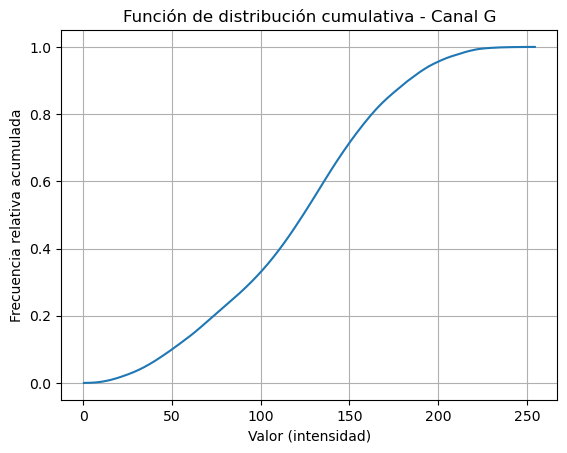

In [198]:
# Función de distribución cumulativa - Canal G
G_cdf, G_bins_cdf = exposure.cumulative_distribution(G)
plt.figure()
plt.plot(G_bins_cdf, G_cdf)
plt.title('Función de distribución cumulativa - Canal G')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencia relativa acumulada')
plt.grid()
plt.show()

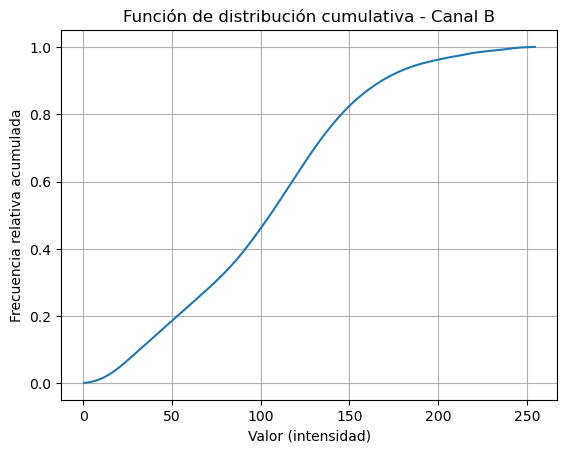

In [199]:
# Función de distribución cumulativa - Canal B
B_cdf, B_bins_cdf = exposure.cumulative_distribution(B)
plt.figure()
plt.plot(B_bins_cdf, B_cdf)
plt.title('Función de distribución cumulativa - Canal B')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencia relativa acumulada')
plt.grid()
plt.show()

Vistas las funciones de distribución cumulativa de los tres canales, se puede apreciar que presentan un comportamiento similar.


Canal R:
1er cuantil (Q1): 109.00, Mediana (Q2): 153.00, 3er cuantil (Q3): 183.00
Rango intercuantil (IQR): 74.00


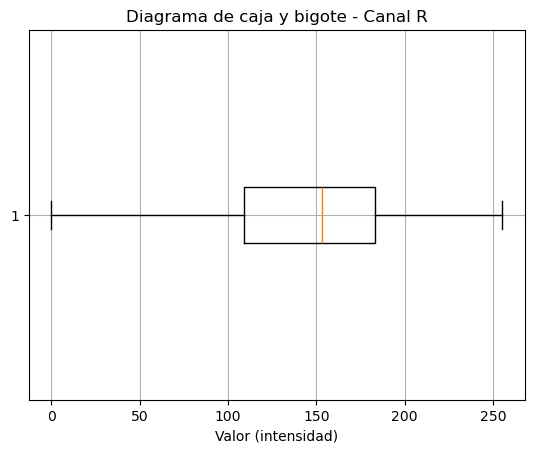

In [200]:
#Apartado 2)c.
# Diagrama de dispersión (caja bigote) - Canal R
R_q = np.quantile(R, (0.25, 0.5, 0.75))
print('\nCanal R:')
print(f'1er cuantil (Q1): {R_q[0]:.2f}, Mediana (Q2): {R_q[1]:.2f}, 3er cuantil (Q3): {R_q[2]:.2f}')
print(f'Rango intercuantil (IQR): {R_q[2]-R_q[0]:.2f}')
plt.figure()
plt.boxplot(R.flatten(), vert=False)
plt.title('Diagrama de caja y bigote - Canal R')
plt.xlabel('Valor (intensidad)')
plt.grid()
plt.show()


Canal G:
1er cuantil (Q1): 85.00, Mediana (Q2): 124.00, 3er cuantil (Q3): 156.00
Rango intercuantil (IQR): 71.00


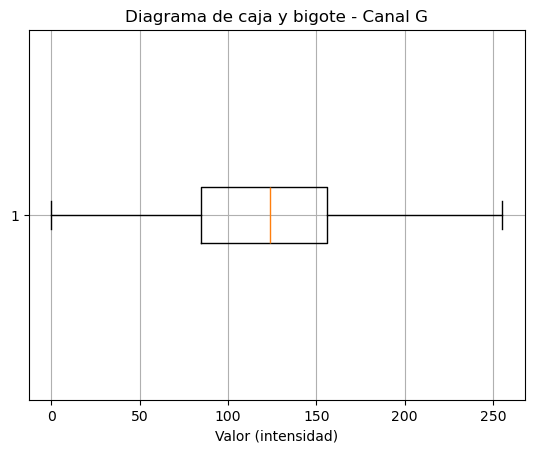

In [201]:
# Diagrama de dispersión (caja bigote) - Canal G
G_q = np.quantile(G, (0.25, 0.5, 0.75))
print('\nCanal G:')
print(f'1er cuantil (Q1): {G_q[0]:.2f}, Mediana (Q2): {G_q[1]:.2f}, 3er cuantil (Q3): {G_q[2]:.2f}')
print(f'Rango intercuantil (IQR): {G_q[2]-G_q[0]:.2f}')
plt.figure()
plt.boxplot(G.flatten(), vert=False)
plt.title('Diagrama de caja y bigote - Canal G')
plt.xlabel('Valor (intensidad)')
plt.grid()
plt.show()


Canal B:
1er cuantil (Q1): 64.00, Mediana (Q2): 106.00, 3er cuantil (Q3): 138.00
Rango intercuantil (IQR): 74.00


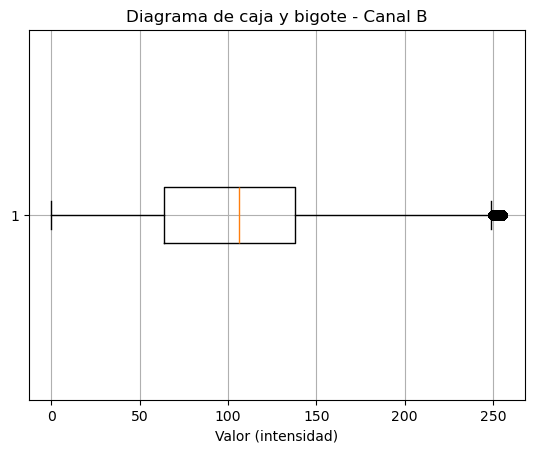

In [202]:
# Diagrama de dispersión (caja bigote) - Canal B
B_q = np.quantile(B, (0.25, 0.5, 0.75))
print('\nCanal B:')
print(f'1er cuantil (Q1): {B_q[0]:.2f}, Mediana (Q2): {B_q[1]:.2f}, 3er cuantil (Q3): {B_q[2]:.2f}')
print(f'Rango intercuantil (IQR): {B_q[2]-B_q[0]:.2f}')
plt.figure()
plt.boxplot(B.flatten(), vert=False)
plt.title('Diagrama de caja y bigote - Canal B')
plt.xlabel('Valor (intensidad)')
plt.grid()
plt.show()

El diagrama de caja y bigote del canal rojo y verde son muy parecidos, con la diferencia de que la caja, en el canal rojo, se encuentra en valores superiores. En el caso del canal azul, aparecen algunos valores atípicos al llegar al entorno del valor 250.

In [203]:
#Apartado 2)e.
img_boston_hsv = img_boston.convert("HSV")

img_boston_hsv_float = np.asarray(img_boston_hsv, dtype = 'float')

# Principales estadísticos
print('Valor mínimo de imagen Boston:', img_boston_hsv_float.min())
print('Valor máximo de imagen Boston:', img_boston_hsv_float.max())
print('Rango de Boston:', img_boston_hsv_float.max() - img_boston_hsv_float.min())
print('Media de Boston:', img_boston_hsv_float.mean())
print('Desviación típica de Boston:', img_boston_hsv_float.std())
print('Varianza de Boston:', img_boston_hsv_float.var())
print('Coeficiente de variación de Boston:', img_boston_hsv_float.std() / img_boston_hsv_float.mean())
img_boston_hsv_q = np.quantile(img_boston_hsv, (0.25, 0.5, 0.75))
print('1er cuantil de Boston (Q1): ', img_boston_hsv_q[0], '\nMediana de Boston (Q2): ', img_boston_hsv_q[1], '\n3er cuantil de Boston (Q3): ', img_boston_hsv_q[2],
     '\nRango intercuantil de Boston (IQR): ', img_boston_hsv_q[2]-img_boston_hsv_q[0], '\nRango medio intercuantil de Boston: ', (img_boston_hsv_q[0]+img_boston_hsv_q[2])/2)

Valor mínimo de imagen Boston: 0.0
Valor máximo de imagen Boston: 255.0
Rango de Boston: 255.0
Media de Boston: 90.99128674746648
Desviación típica de Boston: 68.6581744893372
Varianza de Boston: 4713.944924208273
Coeficiente de variación de Boston: 0.7545576828679026
1er cuantil de Boston (Q1):  21.0 
Mediana de Boston (Q2):  76.0 
3er cuantil de Boston (Q3):  152.0 
Rango intercuantil de Boston (IQR):  131.0 
Rango medio intercuantil de Boston:  86.5


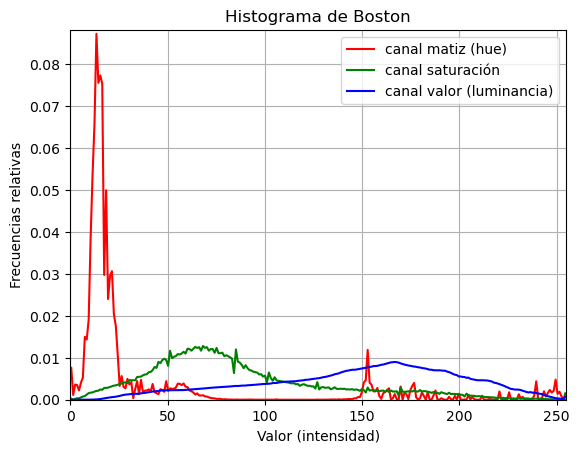

In [204]:
# Histograma
img_boston_hsv_hist, bins = exposure.histogram(img_boston_hsv_float, channel_axis=2, normalize=True)
M = img_boston_hsv_hist.max()

plt.plot(bins, img_boston_hsv_hist[0,:],'r', label='canal matiz (hue)')
plt.plot(bins, img_boston_hsv_hist[1,:],'g', label='canal saturación')
plt.plot(bins, img_boston_hsv_hist[2,:],'b', label='canal valor (luminancia)')

plt.axis([0,255, 0, 1.01*img_boston_hsv_hist.max()])
plt.legend()
plt.title('Histograma de Boston')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencias relativas')
plt.grid()

Al visualizar el histograma de los canales HSV, se puede apreciar que el matiz presenta un pico muy elevado entre 10 y 20. La saturación y la luminancia son mucho más constantes.

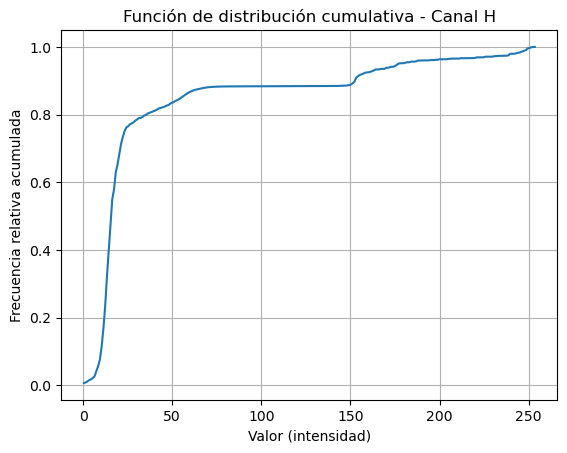

In [205]:
H, S, V = img_boston_hsv_float[:,:,0], img_boston_hsv_float[:,:,1], img_boston_hsv_float[:,:,2]

# Función de distribución cumulativa - Canal H
H_cdf, H_bins_cdf = exposure.cumulative_distribution(H)
plt.figure()
plt.plot(H_bins_cdf, H_cdf)
plt.title('Función de distribución cumulativa - Canal H')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencia relativa acumulada')
plt.grid()
plt.show()

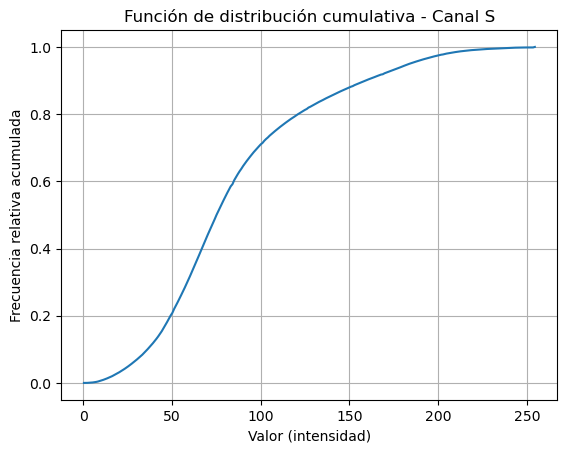

In [206]:
# Función de distribución cumulativa - Canal S
S_cdf, S_bins_cdf = exposure.cumulative_distribution(S)
plt.figure()
plt.plot(S_bins_cdf, S_cdf)
plt.title('Función de distribución cumulativa - Canal S')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencia relativa acumulada')
plt.grid()
plt.show()

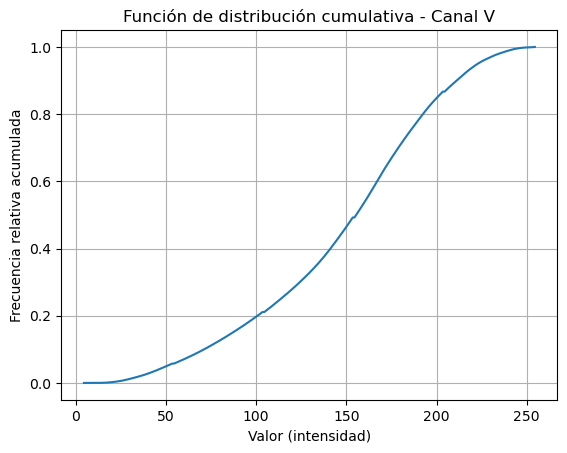

In [207]:
# Función de distribución cumulativa - Canal V
V_cdf, V_bins_cdf = exposure.cumulative_distribution(V)
plt.figure()
plt.plot(V_bins_cdf, V_cdf)
plt.title('Función de distribución cumulativa - Canal V')
plt.xlabel('Valor (intensidad)')
plt.ylabel('Frecuencia relativa acumulada')
plt.grid()
plt.show()

Al igual que se podía ver en el histograma, la función de distribución cumulativa revela que la saturación y la luminancia son bastante constantes o regulares en su distribución, mientras que el matiz es mucho más irregular.


Canal H:
1er cuantil (Q1): 13.00, Mediana (Q2): 16.00, 3er cuantil (Q3): 23.00
Rango intercuantil (IQR): 10.00


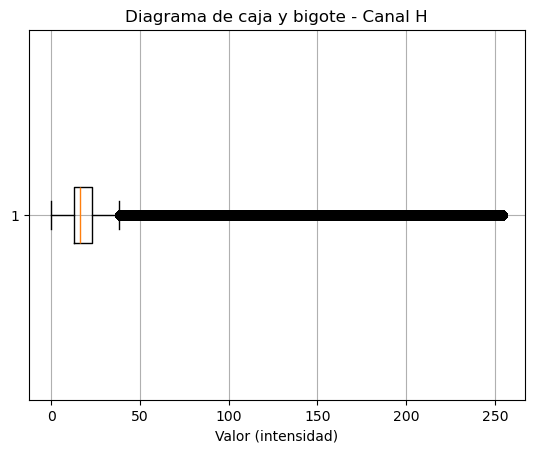

In [208]:
# Diagrama de dispersión (caja bigote) - Canal H
H_q = np.quantile(H, (0.25, 0.5, 0.75))
print('\nCanal H:')
print(f'1er cuantil (Q1): {H_q[0]:.2f}, Mediana (Q2): {H_q[1]:.2f}, 3er cuantil (Q3): {H_q[2]:.2f}')
print(f'Rango intercuantil (IQR): {H_q[2]-H_q[0]:.2f}')
plt.figure()
plt.boxplot(H.flatten(), vert=False)
plt.title('Diagrama de caja y bigote - Canal H')
plt.xlabel('Valor (intensidad)')
plt.grid()
plt.show()


Canal S:
1er cuantil (Q1): 54.00, Mediana (Q2): 75.00, 3er cuantil (Q3): 109.00
Rango intercuantil (IQR): 55.00


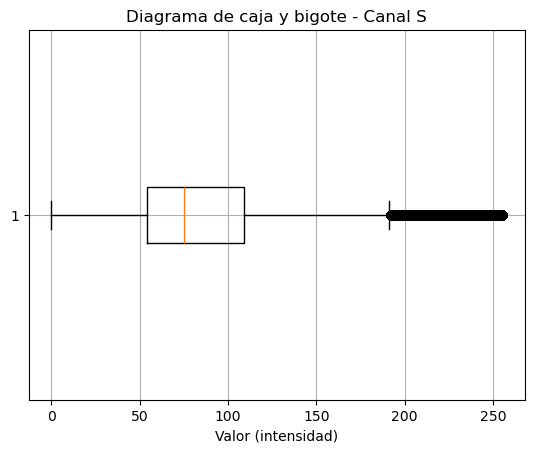

In [209]:
# Diagrama de dispersión (caja bigote) - Canal S
S_q = np.quantile(S, (0.25, 0.5, 0.75))
print('\nCanal S:')
print(f'1er cuantil (Q1): {S_q[0]:.2f}, Mediana (Q2): {S_q[1]:.2f}, 3er cuantil (Q3): {S_q[2]:.2f}')
print(f'Rango intercuantil (IQR): {S_q[2]-S_q[0]:.2f}')
plt.figure()
plt.boxplot(S.flatten(), vert=False)
plt.title('Diagrama de caja y bigote - Canal S')
plt.xlabel('Valor (intensidad)')
plt.grid()
plt.show()


Canal V:
1er cuantil (Q1): 114.00, Mediana (Q2): 155.00, 3er cuantil (Q3): 186.00
Rango intercuantil (IQR): 72.00


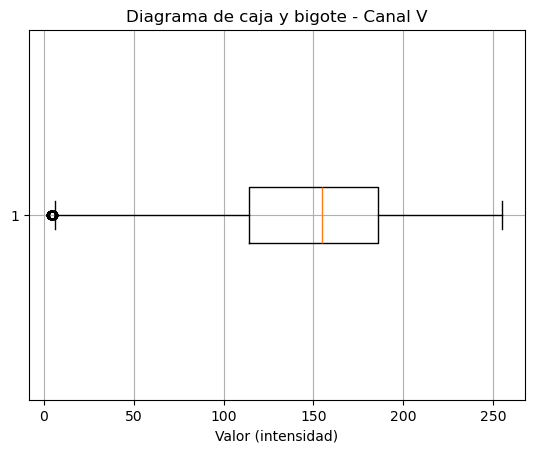

In [210]:
# Diagrama de dispersión (caja bigote) - Canal V
V_q = np.quantile(V, (0.25, 0.5, 0.75))
print('\nCanal V:')
print(f'1er cuantil (Q1): {V_q[0]:.2f}, Mediana (Q2): {V_q[1]:.2f}, 3er cuantil (Q3): {V_q[2]:.2f}')
print(f'Rango intercuantil (IQR): {V_q[2]-V_q[0]:.2f}')
plt.figure()
plt.boxplot(V.flatten(), vert=False)
plt.title('Diagrama de caja y bigote - Canal V')
plt.xlabel('Valor (intensidad)')
plt.grid()
plt.show()

Los canales H y S tienen valores atípicos en los valores altos, mientras que el canal V los tiene en los valores bajos.

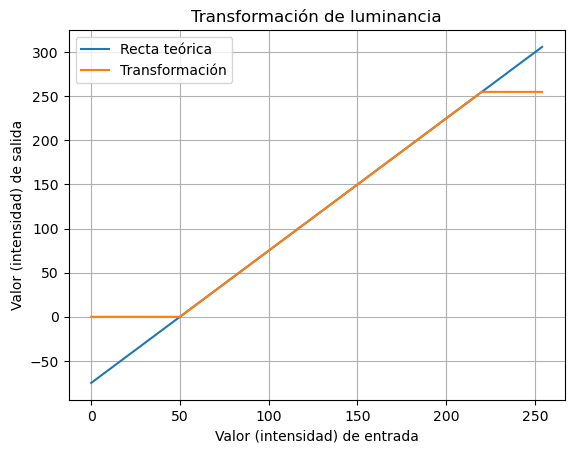

In [211]:
#Apartado 5)

img_boston_float = np.asarray(img_boston, dtype='float') / 255  # Normalizar al rango [0, 1]
img_boston_hsv = color.rgb2hsv(img_boston_float)  # Convertir a HSV
V = img_boston_hsv[:, :, 2]

#Definición de la transformación
Mi = 255

#Como es una imagen de color, la transformación se aplicará solo en la luminancia, intentando aprovechar mejor el rango 0-255.
Lim1 = 50
Lim2= 220

L = (Lim1 + Lim2)/2
W = Lim2 - Lim1

m = Mi/W
b = -Mi*(L/W - 0.5)

# Representación de la transformación

x = np.arange((min(Lim1, 0)), max(Lim2, Mi))
y = m*x +b

y_transf = y.copy()
y_transf[y_transf<0] = 0
y_transf[y_transf>Mi] = Mi

plt.plot(x,y, label='Recta teórica')
plt.plot(x, y_transf, label='Transformación')

plt.legend()
plt.title('Transformación de luminancia')
plt.xlabel('Valor (intensidad) de entrada')
plt.ylabel('Valor (intensidad) de salida')
plt.grid()

In [212]:
V_float = util.img_as_float(V) * Mi
V_transf = V_float * m + b
V_transf[V_transf < 0] = 0
V_transf[V_transf > Mi] = Mi
V_transf = util.img_as_ubyte(V_transf / Mi)
img_boston_hsv_float[:,:,2] = V_transf / Mi
img_boston_corr = color.hsv2rgb(img_boston_hsv_float)

V_float = V * Mi  # Escalar el canal V al rango [0, 255]
V_transf = V_float * m + b
V_transf[V_transf < 0] = 0
V_transf[V_transf > Mi] = Mi
V_transf = V_transf / Mi  # Volver a normalizar al rango [0, 1]

# Sustituir el canal V transformado en la imagen HSV
img_boston_hsv[:, :, 2] = V_transf

# Convertir la imagen transformada de vuelta a RGB
img_boston_corr = color.hsv2rgb(img_boston_hsv)

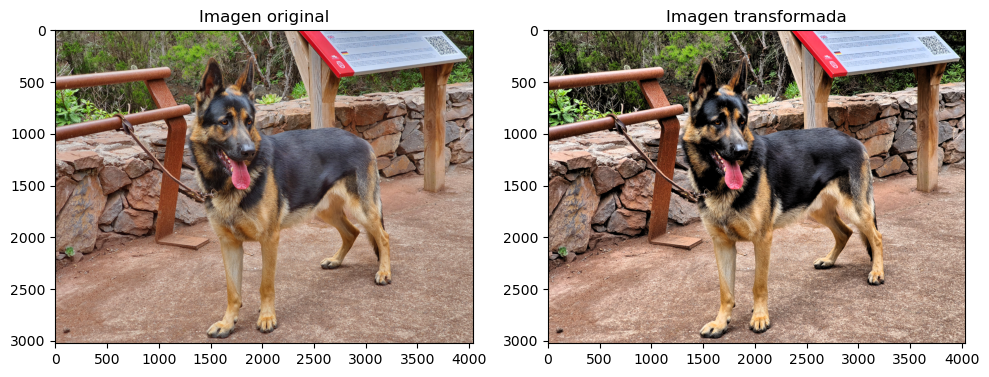

In [213]:
# Visualización de la imagen antes y después de la transformación
plt.figure(figsize=(10, 10))

# Imagen original
plt.subplot(121)
plt.imshow(img_boston)
plt.title('Imagen original')

# Imagen transformada (en RGB)
plt.subplot(122)
plt.imshow(img_boston_corr)
plt.title('Imagen transformada')

plt.tight_layout()
plt.show()

Al aplicar la corrección sobre la luminancia se ha conseguido que los tonos oscuros lo sean aún más y de igual forma con los tonos claros. Este efecto se aprecia considerablemente en el pelaje del perro, que ahora es más contrastado.

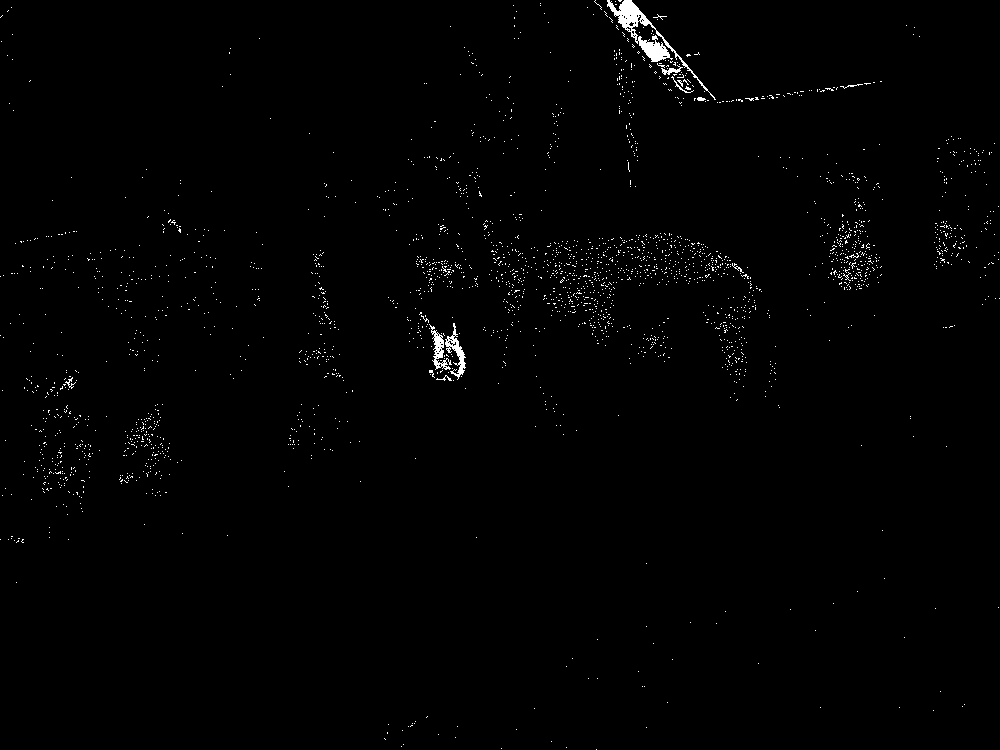

In [214]:
#Apartado 6
img_boston_corr_float = np.array(img_boston_corr)*255
Image.fromarray(np.logical_and(np.logical_and(img_boston_corr_float[:,:,0]>100, img_boston_corr_float[:,:,2]>100), img_boston_corr_float[:,:,1]<110))

Se ha aplicado una máscara para tratar de extraer la lengua del perro. Se seleccionan, de igual forma, algunos colores similares del resto de la imagen.

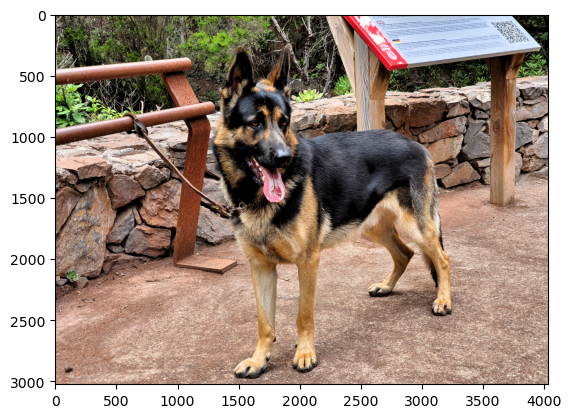

In [215]:
img_boston_hsv = color.rgb2hsv(img_boston_corr)
mask = np.logical_and(np.logical_and(img_boston_corr_float[:,:,0]>100, img_boston_corr_float[:,:,2]>100), img_boston_corr_float[:,:,1]<110)
img_boston_hsv2 = img_boston_hsv.copy()
img_boston_hsv2[mask,1] = 0
img_boston_RGB2 = color.hsv2rgb(img_boston_hsv2)
plt.imshow(img_boston_RGB2)

Con la máscara vista anteriormente, se ha desaturado la lengua.